In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML, display


def initialize_wave_function(L, N, dt, c, initial_condition):
    """
    1D wave equation: Psi_tt = c^2 Psi_xx on [0, L] with fixed Dirichlet BC.
    We discretize space and time on a uniform grid:
        x_i = i * dx,   i = 0,...,N
        t^n = n * dt,   n = 0,1,2,...
    and denote the discrete solution by Psi_i^n.

    This function constructs:
      - spatial grid x
      - CFL-related parameter r = (c dt / dx)^2
      - initial displacement Psi^0 according to the chosen initial condition
      - the first time level Psi^1 using the 'string at rest' condition Psi_t(x,0)=0.

    Returns:
        x, r, psi_prev (= Psi^0), psi_now (= Psi^1)
    """
    dx = L / N
    x = np.linspace(0.0, L, N + 1)

    # CFL condition for the explicit central-difference scheme (stability requirement)
    cfl = c * dt / dx
    if cfl > 1.0:
        raise ValueError(f"CFL condition violated: c*dt/dx = {cfl:.3f} > 1")
    r = cfl**2

    # Initial displacement Psi(x,0) for the three prescribed cases
    if initial_condition == "1":
        psi0 = np.sin(2 * np.pi * x)
    elif initial_condition == "2":
        psi0 = np.sin(5 * np.pi * x)
    elif initial_condition == "3":
        psi0 = np.where((x > 1/5) & (x < 2/5), np.sin(5 * np.pi * x), 0.0)
    else:
        raise ValueError("initial_condition must be '1', '2' or '3'")

    # Impose fixed boundary values at all times: Psi(0,t)=0 and Psi(L,t)=0
    psi0[0] = 0.0
    psi0[-1] = 0.0

    # ---- Initialization for second-order time stepping ----
    # The explicit scheme uses three time levels: Psi^{n-1}, Psi^n, Psi^{n+1}.
    # Hence we must construct Psi^1 in addition to Psi^0.
    #
    # 'String at rest' means: Psi_t(x,0) = 0.
    # Using a central difference at t=0:
    #   Psi_t(x_i,0) ≈ (Psi_i^1 - Psi_i^{-1}) / (2 dt) = 0
    # gives Psi^{-1} = Psi^1.
    #
    # Substituting into the update formula at n=0 yields:
    #   Psi_i^1 = Psi_i^0 + (r/2) * (Psi_{i+1}^0 - 2 Psi_i^0 + Psi_{i-1}^0),
    # for i = 1,...,N-1.
    psi_prev = psi0.copy()  # Psi^0 (will act as Psi^{n-1} later)
    psi_now = psi0.copy()   # will become Psi^1

    psi_now[1:-1] = psi0[1:-1] + 0.5 * r * (psi0[2:] - 2 * psi0[1:-1] + psi0[:-2])
    psi_now[0] = 0.0
    psi_now[-1] = 0.0

    return x, r, psi_prev, psi_now


def time_step(psi_prev, psi_now, psi_next, r):
    """
    One explicit time step for the 1D wave equation using central differences:

      (Psi_i^{n+1} - 2 Psi_i^n + Psi_i^{n-1})/dt^2
        = c^2 (Psi_{i+1}^n - 2 Psi_i^n + Psi_{i-1}^n)/dx^2

    Rearranging gives the explicit update (for i=1,...,N-1):
      Psi_i^{n+1} = 2 Psi_i^n - Psi_i^{n-1}
                   + r (Psi_{i+1}^n - 2 Psi_i^n + Psi_{i-1}^n),
    where r = (c dt / dx)^2.

    The fixed Dirichlet boundary conditions are enforced by setting:
      Psi_0^{n} = 0,  Psi_N^{n} = 0
    at each time step.
    """
    psi_next[1:-1] = (
        2.0 * psi_now[1:-1]
        - psi_prev[1:-1]
        + r * (psi_now[2:] - 2.0 * psi_now[1:-1] + psi_now[:-2])
    )

    # Enforce Dirichlet boundary conditions at the new time level
    psi_next[0] = 0.0
    psi_next[-1] = 0.0

    # Shift time levels: (n-1,n) <- (n,n+1)
    psi_prev[:], psi_now[:] = psi_now, psi_next


def time_evolution(L, N, dt, c, timesteps, initial_condition, selected_times):
    """
    Compute the discrete solution Psi(x,t) at selected time levels.

    Args:
        timesteps: total number of time indices we advance (n = 0,...,timesteps-1)
        selected_times: list of integers n at which we store Psi^n

    Returns:
        x: spatial grid
        solution: dict mapping n -> Psi^n (array on grid)
    """
    x, r, psi_prev, psi_now = initialize_wave_function(L, N, dt, c, initial_condition)
    psi_next = np.zeros_like(psi_now)

    selected_times = set(selected_times)
    solution = {}

    if 0 in selected_times:
        solution[0] = psi_prev.copy()   # Psi^0
    if 1 in selected_times:
        solution[1] = psi_now.copy()    # Psi^1

    # Advance time: after initialization we are at n=1 (psi_now = Psi^1)
    # Next we compute Psi^2, Psi^3, ..., Psi^{timesteps-1}.
    for n in range(1, timesteps - 1):
        time_step(psi_prev, psi_now, psi_next, r)

        # After stepping, psi_now holds Psi^{n+1}
        if (n + 1) in selected_times:
            solution[n + 1] = psi_now.copy()

    return x, solution


def plot_figure(x, solution, dt, title, output_file, show=True):
    """
    Plot Psi(x,t) for several selected time levels in one figure.
    This corresponds to the 'plot at several times in the same figure' requirement.
    """
    fig, ax = plt.subplots(figsize=(8, 5))

    for n in sorted(solution):
        ax.plot(x, solution[n], label=f"t = {n*dt:.3f}")

    ax.set_xlabel("x")
    ax.set_ylabel(r"$\Psi(x,t)$")
    ax.set_title(title)
    ax.legend()
    plt.tight_layout()

    fig.savefig(output_file, dpi=200)

    if show:
        plt.show()

    plt.close(fig)


def animate_wave(L, N, dt, c, timesteps, initial_condition, output_file, fps=30, show=True):
    """
    Create an animation of the discrete time evolution and save it as a GIF.
    Saving the animation ensures the result is available in the repository output.

    Optionally displays the animation inside the notebook (HTML).
    """
    x, r, psi_prev, psi_now = initialize_wave_function(L, N, dt, c, initial_condition)
    psi_next = np.zeros_like(psi_now)

    fig, ax = plt.subplots(figsize=(8, 5))
    line, = ax.plot(x, psi_now, lw=2)

    ax.set_xlim(0.0, L)
    ax.set_ylim(-1.2, 1.2)
    ax.set_xlabel("x")
    ax.set_ylabel(r"$\Psi(x,t)$")
    ax.set_title(f"Wave equation time evolution (IC {initial_condition}, N={N}, dt={dt})")

    def update(_):
        time_step(psi_prev, psi_now, psi_next, r)
        line.set_ydata(psi_now)
        return (line,)

    ani = animation.FuncAnimation(fig, update, frames=timesteps, blit=True)

    ani.save(output_file, writer=animation.PillowWriter(fps=fps))

    if show:
        display(HTML(ani.to_jshtml()))

    plt.close(fig)
    return ani


# Question B

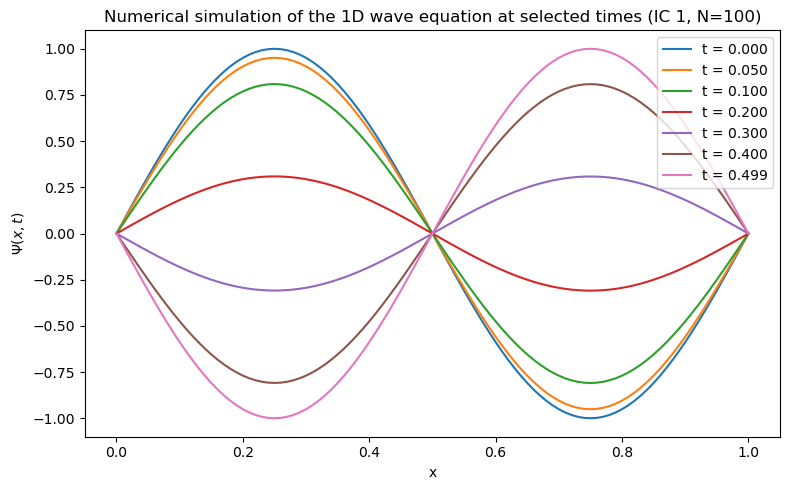

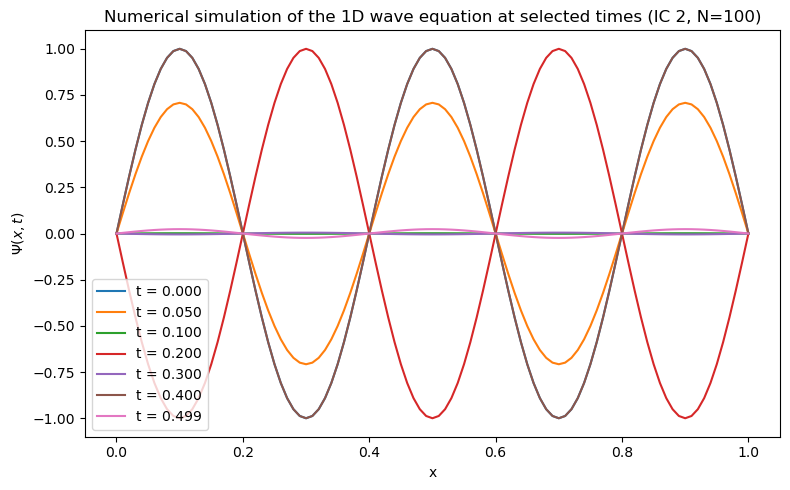

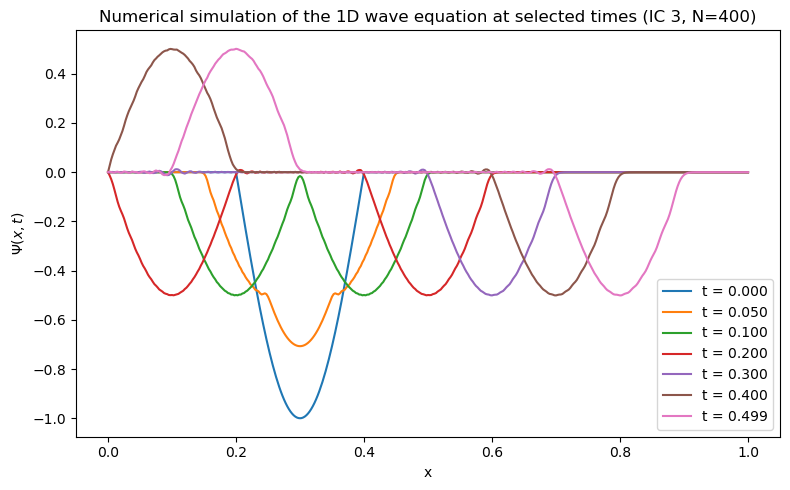

In [ ]:
os.makedirs("outputs", exist_ok=True)

L = 1.0
dt = 0.001
c = 1.0

timesteps_B = 500
selected_times = [0, 50, 100, 200, 300, 400, 499]

N_by_case = {"1": 100, "2": 100, "3": 400}

for initial_condition in ["1", "2", "3"]:
    N = N_by_case[initial_condition]
    x, solution = time_evolution(
        L=L, N=N, dt=dt, c=c,
        timesteps=timesteps_B,
        initial_condition=initial_condition,
        selected_times=selected_times
    )

    plot_figure(
        x=x,
        solution=solution,
        dt=dt,
        title=f"Numerical simulation of the 1D wave equation at selected times (IC {initial_condition}, N={N})",
        output_file=f"outputs/B_wave_equation_IC{initial_condition}_N{N}.png",
        show=True
    )


# Question C

In [ ]:
timesteps_C = 300
fps = 30

for initial_condition in ["1", "2", "3"]:
    N = N_by_case[initial_condition]
    animate_wave(
        L=L, N=N, dt=dt, c=c,
        timesteps=timesteps_C,
        initial_condition=initial_condition,
        output_file=f"outputs/C_wave_animation_IC{initial_condition}_N{N}.gif",
        fps=fps,
        show=True
    )
